In [1]:
import os, sys
SOFTWARE_DIR = '%s/lartpc_mlreco3d' % os.environ.get('HOME') # Path to your `lartpc_mlreco3d`
DATA_DIR = '/sdf/home/b/bearc/data/sbnd'
# Set software directory
sys.path.append(SOFTWARE_DIR)

In [15]:
import numpy as np
import yaml
import torch
import plotly
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode(connected=False)

from mlreco.visualization import scatter_points, plotly_layout3d
from mlreco.visualization.gnn import scatter_clusters, network_topology, network_schematic
from mlreco.utils.ppn import uresnet_ppn_type_point_selector
from mlreco.utils.cluster.dense_cluster import fit_predict_np, gaussian_kernel
from mlreco.main_funcs import process_config, prepare
from mlreco.utils.gnn.cluster import get_cluster_label
from mlreco.utils.deghosting import adapt_labels_numpy as adapt_labels
from mlreco.visualization.gnn import network_topology

from larcv import larcv

from analysis.classes.ui import FullChainEvaluator

#my helpers
import helpers
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
fnames = ['larcv_100_10_2.root','larcv_100_15_3.root','larcv_100_5_1.root','larcv_75_10_2.root','larcv_50_10_2.root','larcv_25_10_2.root']

In [24]:
cfg = """
iotool:
  batch_size: 32
  shuffle: False
  num_workers: 4
  collate_fn: CollateSparse
  dataset:
    name: LArCVDataset
    data_keys:
      - DATA_DIR/LARCVFILE
    limit_num_files: 10
    #event_list: '[6436, 562, 3802, 6175, 15256]'
    schema:
      input_data:
        parser: parse_sparse3d
        args:
          sparse_event_list:
            - sparse3d_reco_cryoW
            - sparse3d_reco_cryoW_chi2
            - sparse3d_reco_cryoW_hit_charge0
            - sparse3d_reco_cryoW_hit_charge1
            - sparse3d_reco_cryoW_hit_charge2
            - sparse3d_reco_cryoW_hit_key0
            - sparse3d_reco_cryoW_hit_key1
            - sparse3d_reco_cryoW_hit_key2
      segment_label:
        parser: parse_sparse3d
        args:
          sparse_event_list:
            - sparse3d_pcluster_semantics_ghost
      cluster_label:
        parser: parse_cluster3d
        args:
          cluster_event: cluster3d_pcluster
          particle_event: particle_pcluster
          sparse_semantics_event: sparse3d_pcluster_semantics
          add_particle_info: True
          type_include_mpr: true
      particles_label:
        parser: parse_particle_points
        args:
          sparse_event: sparse3d_pcluster
          particle_event: particle_corrected
          include_point_tagging: true
      simenergydeposits:
        parser: parse_cluster3d
        args:
          cluster_event: cluster3d_sed
          clean_data: false
      energy:
        parser: parse_sparse3d
        args:
          sparse_event_list:
            - sparse3d_pcluster
          
""".replace('DATA_DIR',DATA_DIR)

cfgs = []
for _,fname in enumerate(fnames):
    cfg_copy = cfg #Make dumby copy
    cfgs.append(cfg_copy.replace('LARCVFILE',fname))

In [25]:
def load_cfg(cfg):
    """
    return dataset just from cfg
    """
    cfg=yaml.load(cfg,Loader=yaml.Loader)
    # pre-process configuration (checks + certain non-specified default settings)
    process_config(cfg)
    # prepare function configures necessary "handlers"
    hs=prepare(cfg)
    dataset = hs.data_io_iter
    data = next(hs.data_io_iter)
    return data
    

In [26]:
entry = 0
data = load_cfg(cfgs[0])


Config processed at: Linux tur022 3.10.0-1160.42.2.el7.x86_64 #1 SMP Tue Sep 7 14:49:57 UTC 2021 x86_64 x86_64 x86_64 GNU/Linux

$CUDA_VISIBLE_DEVICES="0"

iotool:
  batch_size: 32
  collate_fn: CollateSparse
  dataset:
    data_keys: [/sdf/home/b/bearc/data/sbnd/larcv_100_10_2.root]
    limit_num_files: 10
    name: LArCVDataset
    schema:
      cluster_label:
        args: {add_particle_info: true, cluster_event: cluster3d_pcluster, particle_event: particle_pcluster,
          sparse_semantics_event: sparse3d_pcluster_semantics, type_include_mpr: true}
        parser: parse_cluster3d
      energy:
        args:
          sparse_event_list: [sparse3d_pcluster]
        parser: parse_sparse3d
      input_data:
        args:
          sparse_event_list: [sparse3d_reco_cryoW, sparse3d_reco_cryoW_chi2, sparse3d_reco_cryoW_hit_charge0,
            sparse3d_reco_cryoW_hit_charge1, sparse3d_reco_cryoW_hit_charge2, sparse3d_reco_cryoW_hit_key0,
            sparse3d_reco_cryoW_hit_key1, spars

In [28]:
clust_label = data['cluster_label'][data['cluster_label'][:, 0] == entry]
energy_label = data['energy'][data['energy'][:,0] == entry]
input_data = data['input_data'][data['input_data'][:, 0] == entry]
segment_label = data['segment_label'][data['segment_label'][:, 0] == entry,-1]
particles_label = data['particles_label'][data['particles_label'][:, 0] == entry]
simenergydeposit_label = data['simenergydeposits'][data['simenergydeposits'][:, 0] == entry]

In [30]:
energy_label[0]

array([  0.        , 627.        , 530.        ,  29.        ,
        13.67670155])

In [31]:
reco_xyz_noghost = input_data[segment_label<5,1:4]
true_xyz = simenergydeposit_label[:,1:4]

pur,eff,tagged,true_indeces,reco_indeces = helpers.purity_efficiency(reco_xyz_noghost,true_xyz,distance=np.sqrt(1e10))
reco_xyz_noghost_unmatched = np.array([coord for coord in reco_xyz_noghost if coord not in tagged])
pur,eff

#reco_xyz_noghost[[0,3,4]]

#pur = 0.283
#75_10_2 = (0.29202000434877146, 0.20984375)
#50_10_2 = (0.29202000434877146, 0.20961448415795225)
#25_10_2 = (0.2913676886279626, 0.20862525299704188)
#np.round(reco_xyz_noghost),np.round(true_xyz)
np.unique(true_xyz[true_indeces,None]-tagged[:,None],return_counts=True),np.unique(np.linalg.norm(true_xyz[true_indeces]-tagged,axis=1),return_counts=True)
np.unique(true_xyz[true_indeces,0]-tagged[:,0],return_counts=True)
len(reco_indeces),len(reco_xyz_noghost)
#len(true_indeces),len(reco_indeces)

(6380, 6380)

In [32]:
purs,effs = np.zeros((len(fnames),12)),np.zeros((len(fnames),12)) #purity and eff values for distance of 0,1,2
distances = [0,1,1e10,3]
axes = [None,0,1,2]
ax_str = ['none','x','y','z']
matching_dict = {}
for i,fname in enumerate(fnames):
    hyperparams = fname[6:-5].split("_")
    ne = int(hyperparams[0]) #number of electrons
    tw = int(hyperparams[1]) #tick window
    vds = int(hyperparams[2]) #voxel distance seperation
    data = load_cfg(cfgs[i])
    clust_label = data['cluster_label'][data['cluster_label'][:, 0] == entry]
    input_data = data['input_data'][data['input_data'][:, 0] == entry]
    segment_label = data['segment_label'][data['segment_label'][:, 0] == entry,-1]
    particles_label = data['particles_label'][data['particles_label'][:, 0] == entry]
    simenergydeposit_label = data['simenergydeposits'][data['simenergydeposits'][:, 0] == entry]
    
    reco_xyz_noghost = input_data[segment_label<5,1:4]
    true_xyz = simenergydeposit_label[:,1:4]
    
    #Iterate through axes and distances to calculate separations along various axes
    for _,dist in enumerate(distances):
        key = f'ne{ne}_tw{tw}_vds{vds}_d{dist}'
        pur,eff,tagged,true_indeces,reco_indeces = helpers.purity_efficiency(reco_xyz_noghost,true_xyz,distance=np.sqrt(dist))
        #matching_dict[key] = [pur,eff]
        distance_dict = {}
        for j,axis in enumerate(axes):
            if axis is None:
                separations,counts = np.unique(np.linalg.norm(true_xyz[true_indeces]-tagged,axis=1),return_counts=True)
            else:
                separations,counts = np.unique(true_xyz[true_indeces,axis]-tagged[:,axis],return_counts=True)
            distance_dict[f'axis_{ax_str[j]}'] = [separations,counts]
        matching_dict[key] = [ne,tw,vds,dist,pur,eff,distance_dict]

    #print(fname,len())
    


Config processed at: Linux tur022 3.10.0-1160.42.2.el7.x86_64 #1 SMP Tue Sep 7 14:49:57 UTC 2021 x86_64 x86_64 x86_64 GNU/Linux

$CUDA_VISIBLE_DEVICES="0"

iotool:
  batch_size: 32
  collate_fn: CollateSparse
  dataset:
    data_keys: [/sdf/home/b/bearc/data/sbnd/larcv_100_10_2.root]
    limit_num_files: 10
    name: LArCVDataset
    schema:
      cluster_label:
        args: {add_particle_info: true, cluster_event: cluster3d_pcluster, particle_event: particle_pcluster,
          sparse_semantics_event: sparse3d_pcluster_semantics, type_include_mpr: true}
        parser: parse_cluster3d
      energy:
        args:
          sparse_event_list: [sparse3d_pcluster]
        parser: parse_sparse3d
      input_data:
        args:
          sparse_event_list: [sparse3d_reco_cryoW, sparse3d_reco_cryoW_chi2, sparse3d_reco_cryoW_hit_charge0,
            sparse3d_reco_cryoW_hit_charge1, sparse3d_reco_cryoW_hit_charge2, sparse3d_reco_cryoW_hit_key0,
            sparse3d_reco_cryoW_hit_key1, spars


Config processed at: Linux tur022 3.10.0-1160.42.2.el7.x86_64 #1 SMP Tue Sep 7 14:49:57 UTC 2021 x86_64 x86_64 x86_64 GNU/Linux

$CUDA_VISIBLE_DEVICES="0"

iotool:
  batch_size: 32
  collate_fn: CollateSparse
  dataset:
    data_keys: [/sdf/home/b/bearc/data/sbnd/larcv_50_10_2.root]
    limit_num_files: 10
    name: LArCVDataset
    schema:
      cluster_label:
        args: {add_particle_info: true, cluster_event: cluster3d_pcluster, particle_event: particle_pcluster,
          sparse_semantics_event: sparse3d_pcluster_semantics, type_include_mpr: true}
        parser: parse_cluster3d
      energy:
        args:
          sparse_event_list: [sparse3d_pcluster]
        parser: parse_sparse3d
      input_data:
        args:
          sparse_event_list: [sparse3d_reco_cryoW, sparse3d_reco_cryoW_chi2, sparse3d_reco_cryoW_hit_charge0,
            sparse3d_reco_cryoW_hit_charge1, sparse3d_reco_cryoW_hit_charge2, sparse3d_reco_cryoW_hit_key0,
            sparse3d_reco_cryoW_hit_key1, sparse

In [207]:
matching_dict

{'ne100_tw10_vds2_d0': [100,
  10,
  2,
  0,
  0.21018808777429468,
  0.29158512720156554,
  {'axis_none': [array([0.]), array([1341])],
   'axis_x': [array([0.]), array([1341])],
   'axis_y': [array([0.]), array([1341])],
   'axis_z': [array([0.]), array([1341])]}],
 'ne100_tw10_vds2_d1': [100,
  10,
  2,
  1,
  0.6142633228840125,
  0.5864318330071755,
  {'axis_none': [array([0., 1.]), array([1341, 2578])],
   'axis_x': [array([-1.,  0.,  1.]), array([1079, 2735,  105])],
   'axis_y': [array([-1.,  0.,  1.]), array([ 594, 3261,   64])],
   'axis_z': [array([-1.,  0.,  1.]), array([ 415, 3183,  321])]}],
 'ne100_tw10_vds2_d10000000000.0': [100,
  10,
  2,
  10000000000.0,
  1.0,
  0.6507936507936508,
  {'axis_none': [array([0.        , 1.        , 1.41421356, 1.73205081, 2.        ,
           2.23606798, 2.44948974, 2.82842712, 3.        , 3.16227766,
           3.31662479, 3.60555128]),
    array([1341, 2578, 1398,  368,  235,  301,   79,   21,   32,   23,    2,
              2])],


Exception ignored in: <function _ConnectionBase.__del__ at 0x7fdc15ac1b80>
Traceback (most recent call last):
  File "/usr/lib/python3.8/multiprocessing/connection.py", line 132, in __del__
    self._close()
  File "/usr/lib/python3.8/multiprocessing/connection.py", line 361, in _close
    _close(self._handle)
OSError: [Errno 9] Bad file descriptor


18


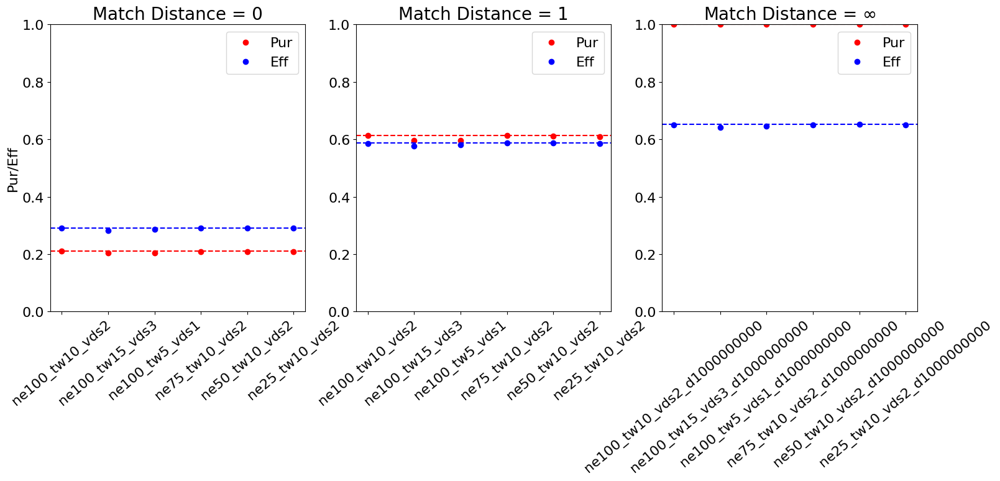

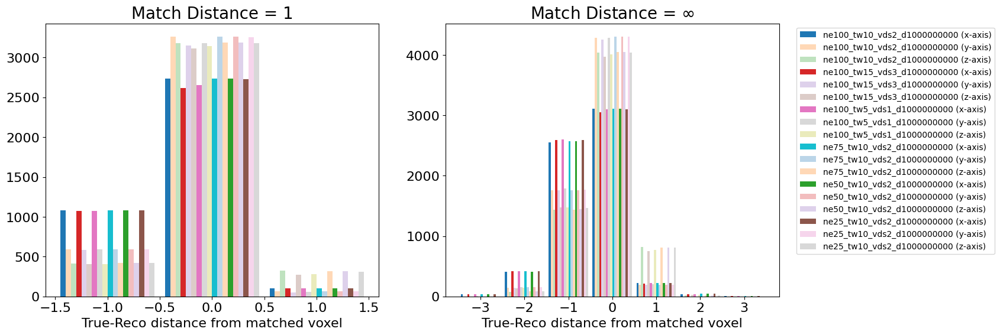

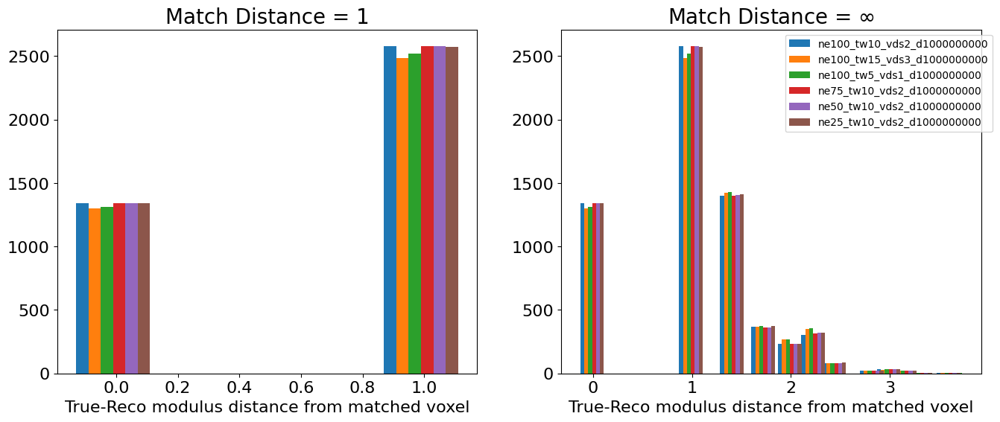

In [33]:
helpers.plot_matching_dict(matching_dict)

([0, 1, 2, 3, 4, 5],
 [Text(0, 0, 'larcv_100_10_2.root'),
  Text(1, 0, 'larcv_100_15_3.root'),
  Text(2, 0, 'larcv_100_5_1.root'),
  Text(3, 0, 'larcv_75_10_2.root'),
  Text(4, 0, 'larcv_50_10_2.root'),
  Text(5, 0, 'larcv_25_10_2.root')])

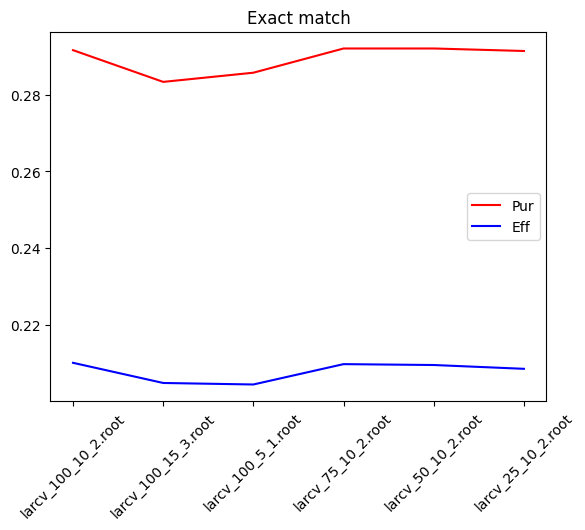

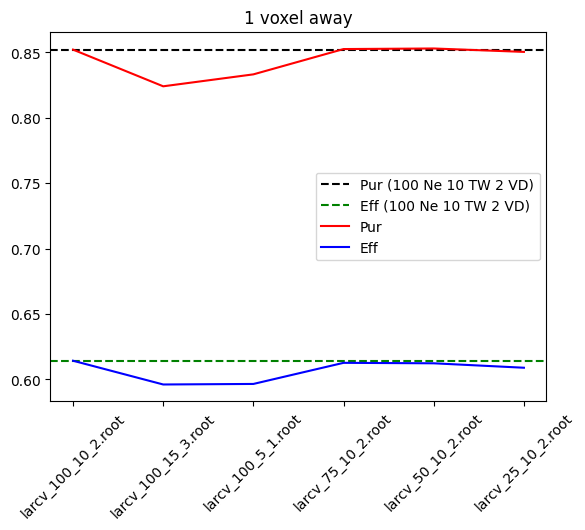

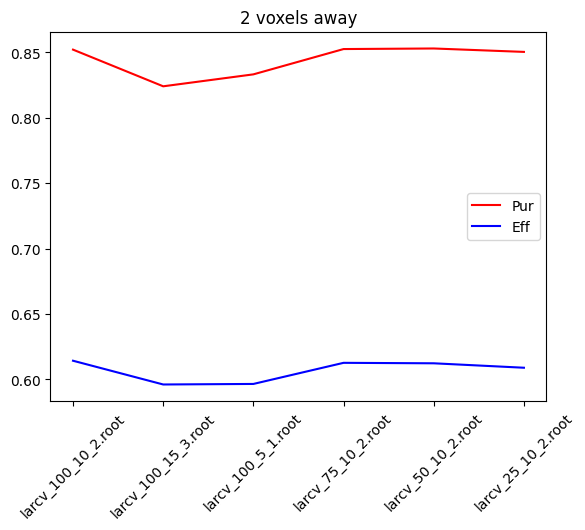

In [11]:
colors = ['r','b','g']

plt.figure()
plt.plot(fnames,purs[:,0],color=colors[0],label='Pur')
plt.plot(fnames,effs[:,0],color=colors[1],label='Eff')
plt.title('Exact match')
plt.legend()
plt.xticks(rotation = 45) # Rotates X-Axis Ticks by 45-degrees

plt.figure()
plt.axhline(purs[0,1],label='Pur (100 Ne 10 TW 2 VD)',color='black',ls='--')
plt.axhline(effs[0,1],label='Eff (100 Ne 10 TW 2 VD)',color='green',ls='--')
plt.plot(fnames,purs[:,1],color=colors[0],label='Pur')
plt.plot(fnames,effs[:,1],color=colors[1],label='Eff')
plt.title('1 voxel away')
plt.legend()
plt.xticks(rotation = 45) # Rotates X-Axis Ticks by 45-degrees

plt.figure()
plt.plot(fnames,purs[:,2],color=colors[0],label='Pur')
plt.plot(fnames,effs[:,2],color=colors[1],label='Eff')
plt.title('2 voxels away')
plt.legend()
plt.xticks(rotation = 45) # Rotates X-Axis Ticks by 45-degrees

In [20]:
xmin,xmax,ymin,ymax,zmin,zmax = 610.,630.,520.,540.,20.,40.
reco_bounded = helpers.bbox_voxels(reco_xyz_noghost,xmin,xmax,ymin,ymax,zmin,zmax)
true_bounded = helpers.bbox_voxels(true_xyz,xmin,xmax,ymin,ymax,zmin,zmax)
tagged_bounded = helpers.bbox_voxels(tagged,xmin,xmax,ymin,ymax,zmin,zmax)
#helpers.bbox_voxels(reco_xyz_noghost,0,2000,0,2000,0,2000)

In [21]:
trace = []

trace+= scatter_points(true_bounded,opacity=0.3,color='blue',markersize=4)
trace[-1].name = f'True voxels (Bounded)'

trace+= scatter_points(reco_bounded,opacity=0.3,color='red',markersize=4)
trace[-1].name = f'Reco voxels (Bounded)'

trace+= scatter_points(tagged_bounded,opacity=0.3,color='yellow',markersize=4)
trace[-1].name = f'Tagged voxels (Bounded)'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(#title=,
                  title={
                    'text': 'Ne = 25 Hit window ticks = 10 Voxel Distance Threshold = 2',
        'y':0.9,
        'x':0.5,
        #'xanchor': 'center',
        #'yanchor': 'top'},
                  },
                  legend=dict(x=1.0, y=0.8))

fig.show()


In [43]:
trace = []

#trace+= scatter_points(tagged,markersize=2)
#trace[-1].name = f'Tagged true voxels (eff = {eff:.2f})'

trace+= scatter_points(simenergydeposit_label,opacity=0.1,color='blue',markersize=2)
trace[-1].name = f'True voxels (pur = {pur:.2f})'

#trace+= scatter_points(reco_xyz_noghost_unmatched,opacity=0.1,color='red',markersize=2)
#trace[-1].name = f'Reco voxels \n(nonghost & unmatched)'

trace+= scatter_points(tagged,opacity=1,color='yellow',markersize=2)
trace[-1].name = f'Reco voxels \n(nonghost & matched, eff = {eff:.2f})'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(#title=,
                  title={
                    'text': 'Ne = 100 Hit window ticks = 10 Voxel Distance Threshold = 2\nMatch Threshold = 1',
        'y':0.9,
        'x':0.5,
        #'xanchor': 'center',
        #'yanchor': 'top'},
                  },
                  legend=dict(x=1.0, y=0.8))

fig.show()
#iplot(fig)

In [23]:
#Sanity check
arr1 = np.array([[1,2,3],[2,3,4],[3,3,3]])
arr2 = np.array([[1,2,3],[2,3,4],[3,3,3],[3,3,2]])
arr3 = [[2,2]]
arr4 = [[1,3,2],[2,3,4],[3,3,3]]

print(helpers.purity_efficiency(arr2,arr1,distance=1))
#print(helpers.purity_efficiency(arr2,arr1))
#print(helpers.purity_efficiency(arr1,arr3))
#print(helpers.purity_efficiency(arr1,arr4))
a = [1,2,3]
a.append(4)
a.pop(0)
#print(np.sum(np.array(arr2[0])-np.array(arr1[0])))
print(a)

(1.3333333333333333, 1.0, array([[1, 2, 3],
       [2, 3, 4],
       [3, 3, 3],
       [3, 3, 2]]))
[2, 3, 4]


In [24]:
ind=2
segment = data['segment_label'][data['segment_label'][:, 0] == entry]
segment[ind],input_data[ind]
len(input_data),len(clust_label)
input_data[0]

array([0.00000000e+00, 6.27000000e+02, 5.30000000e+02, 2.80000000e+01,
       2.87732568e+03, 1.52932179e+00, 7.79225293e+03, 2.10236841e+03,
       5.57721924e+02, 5.17400000e+03, 5.18100000e+03, 5.16700000e+03])

array([  0.        , 628.        , 530.        ,  28.        ,
         1.71544373,  20.        ])

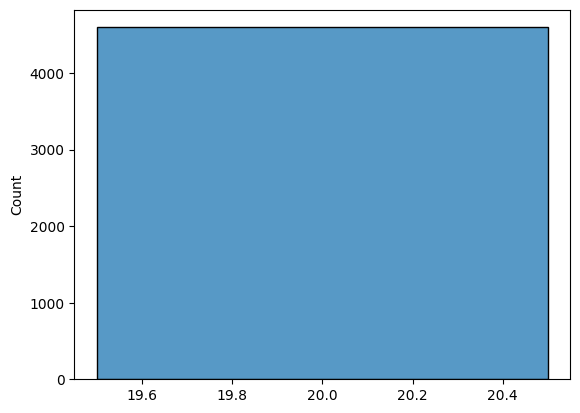

In [25]:
import seaborn as sns
sns.histplot(simenergydeposit_label[:,5])
#sns.histplot([segment[segment_label<5,3],simenergydeposit_label[:,3]])
simenergydeposit_label[5]

In [26]:
def efficiency_calc(reco,true):
    reco_x = reco[:,1]
    reco_y = reco[:,2]
    reco_z = reco[:,3]
    
    true_x = true[:,1]
    true_y = true[:,2]
    true_z = true[:,3]
    
    matches = 0
    for i,x_val in enumerate(reco_x):
        if reco_x[i] in true_x and reco_y[i] in true_y and reco_z[i] in true_z:
            matches+=1
    print(matches,len(reco_x))
    return matches/len(reco_x)

def purity_calc(segment_label,clust_label):
    return len(segment_label[segment_label < 5])/len(clust_label)
    
    

In [27]:
efficiency_calc(input_data,simenergydeposit_label)
clust_label[0]
#purity_calc(segment_label)

18088 18275


array([  0.        , 627.        , 530.        ,  29.        ,
        13.67670155,   4.        ,   4.        ,   0.        ,
         1.        ,   4.        ,   0.        ,   1.        ])

<AxesSubplot: ylabel='Count'>

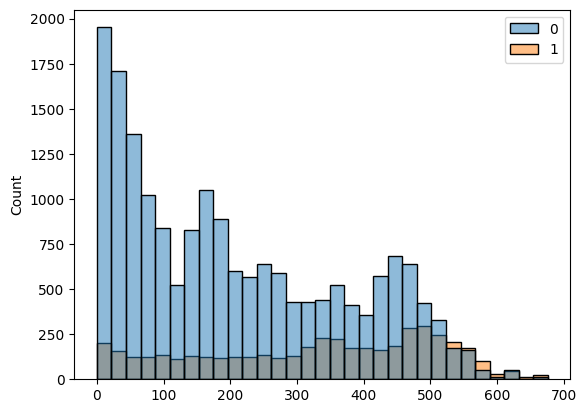

In [28]:
input_data.shape,simenergydeposit_label.shape
input_data[0]
#segment_label
#sns.describe(particles_label)
sns.histplot([input_data[:,2],simenergydeposit_label[:,2]])

In [29]:
np.unique(segment_label, return_counts=True)

(array([0., 1., 2., 4., 5.]), array([  464,  5643,   300,    16, 11852]))

Exception in thread QueueFeederThread:
Traceback (most recent call last):
  File "/usr/lib/python3.8/multiprocessing/queues.py", line 235, in _feed
    close()
  File "/usr/lib/python3.8/multiprocessing/connection.py", line 177, in close
    self._close()
  File "/usr/lib/python3.8/multiprocessing/connection.py", line 361, in _close
    _close(self._handle)
OSError: [Errno 9] Bad file descriptor

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/lib/python3.8/threading.py", line 932, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.8/threading.py", line 870, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.8/multiprocessing/queues.py", line 266, in _feed
    queue_sem.release()
ValueError: semaphore or lock released too many times
Exception ignored in: <function _ConnectionBase.__del__ at 0x7f06c6145b80>
Traceback (most recent call last):
  File "/usr/lib/python3.8/multiprocessing

<AxesSubplot: ylabel='Count'>

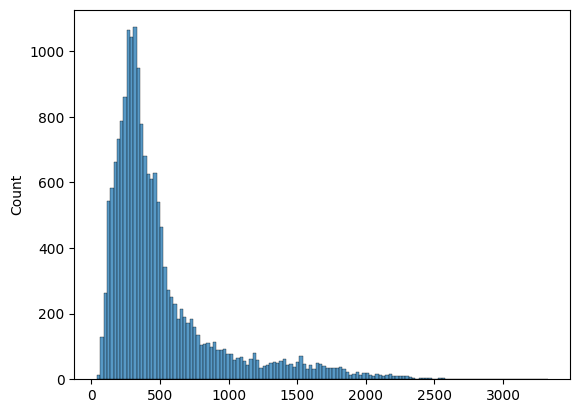

In [30]:
import seaborn as sns
segment_label
sns.histplot(input_data[:,4])

In [72]:
trace = []

#trace+= scatter_points(input_data,markersize=1,color=segment_label, cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
#trace[-1].name = 'Semantic segmentation labels (including ghost points)'
#trace[-1].marker.colorscale='viridis'

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=segment_label[segment_label < 5], cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (w/o ghost points)'
trace[-1].marker.colorscale='viridis'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [32]:
trace = []

trace+= scatter_points(simenergydeposit_label,markersize=1,color=simenergydeposit_label[:, -2], cmin=0,cmax=500)
trace[-1].name = 'Sim energy deposit labels'
trace[-1].marker.colorscale='viridis'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [33]:
trace = []

trace+= scatter_points(input_data,markersize=1,color=segment_label, cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (including ghost points)'
trace[-1].marker.colorscale='viridis'

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=segment_label[segment_label < 5], cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (w/o ghost points)'
trace[-1].marker.colorscale='viridis'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [34]:
trace = []

trace+= scatter_points(input_data,markersize=1,color=input_data[:, -2], cmin=0,cmax=500)
trace[-1].name = 'input_data'
trace[-1].marker.colorscale='viridis_r'

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=input_data[segment_label < 5, -2], cmin=0,cmax=500)
trace[-1].name = 'input_data (true noghost)'
trace[-1].marker.colorscale='viridis'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [35]:
trace = []

trace+= scatter_points(input_data,markersize=1,color=input_data[:, -2])
trace[-1].name = 'input_data'
trace[-1].marker.colorscale='viridis_r'

#trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=input_data[segment_label < 5,-2])
#trace[-1].name = 'input_data (true noghost)'
#trace[-1].marker.colorscale='viridis'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [36]:
trace = []

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=segment_label[segment_label < 5], cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (w/o ghost points)'
trace[-1].marker.colorscale='viridis'

trace += scatter_points(particles_label, markersize=5, color=particles_label[:, 5], cmin=0, cmax=10, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = "True point labels"

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [37]:
particles_label[:,5]
#clust_label.shape,input_data[segment_label<5].shape

array([ 0.,  0.,  1.,  1.,  2.,  2.,  3.,  3.,  4.,  4.,  5.,  5.,  6.,
        6.,  7.,  7.,  8., 10., 11., 12., 18.])

In [ ]:
#Perform PCA
from sklearn.decomposition import PCA

pid = 2
mask = clust_label[:,6]==pid
mask_particle = particles_label[:,5] == pid

pca = PCA(n_components=2)
# Fit the points
pca.fit(clust_label[mask,1:4])
# Project the points onto the 2D line
points_2d = pca.transform(clust_label[mask,1:4])
transformed_points = pca.inverse_transform(points_2d) #Project points along 3d line
line = particles_label[mask_particle,1:4]
line[1]-line[0]


projected_points = helpers.project_points_onto_line(clust_label[mask,1:4],line[0],line[1])
input_data_mask = helpers.match_input_cluster(clust_label[mask],input_data)
energy_label_mask = helpers.match_input_cluster(clust_label[mask],energy_label)


TypeError: 'NoneType' object cannot be interpreted as an integer

In [83]:
input_data_ng = input_data[segment_label<5]
#energy_label_ng = energy_label[segment_label<5]
for pid in range(8):
    print('pid : ',pid)
    print('dQdx :',helpers.dQ_dx_calc(clust_label,particles_label,input_data_ng,pid))
    print('dNdx :',helpers.dN_dx_calc(clust_label,particles_label,input_data_ng,pid))
    print('dEdx :',helpers.dE_dx_calc(clust_label,particles_label,energy_label,pid))
    print('G/track length :',helpers.gap_length_calc(clust_label,particles_label,pid))

pid :  0


IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

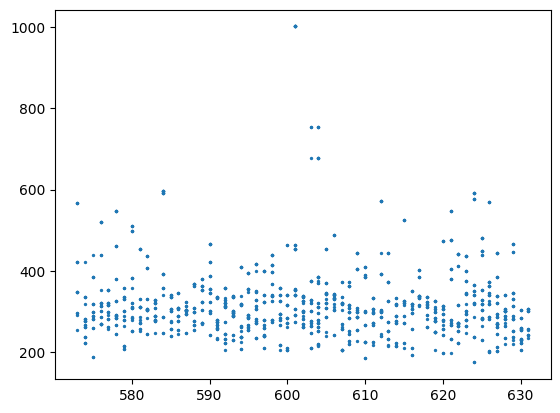

In [310]:
#plt.plot(input_data_mask[:,1],input_data_mask[:,-2])
plt.scatter(input_data_mask[:,1],input_data_mask[:,-5],s=2)

array([0.00000000e+00, 6.27000000e+02, 5.30000000e+02, 2.80000000e+01,
       2.87732568e+03, 1.52932179e+00, 7.79225293e+03, 2.10236841e+03,
       5.57721924e+02, 5.17400000e+03, 5.18100000e+03, 5.16700000e+03])

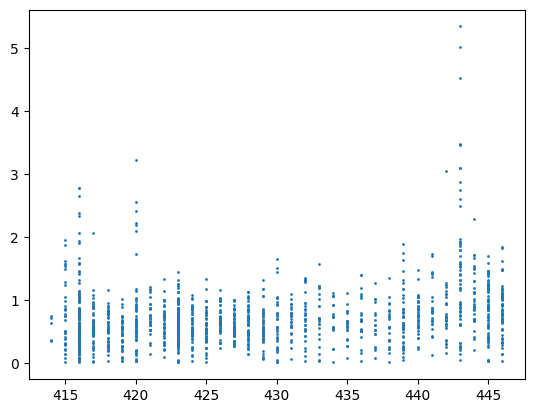

In [293]:
plt.scatter(clust_label[mask,1],clust_label[mask, 4],s=1)
input_data[0]

In [75]:
trace = []
trace+= scatter_points(input_data_mask,markersize=2,
                      color=np.linalg.norm(input_data_mask[:,helpers.input_planecharge_indeces],axis=1),
                      #cmin=np.min(clust_label[mask, 4]),
                      #cmax=1,
                      colorscale='viridis_r')
trace[-1].name = 'Input data Q'

trace += scatter_points(particles_label[mask_particle],
                        markersize=8, 
                        color=particles_label[mask_particle, 5], 
                        cmin=0, cmax=10, 
                        colorscale=plotly.colors.qualitative.D3,
                        line = dict(color=particles_label[mask_particle, 5],
                                  width=5))
trace[-1].name = "True point labels"

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [69]:


trace = []

#trace+= scatter_points(clust_label[mask],markersize=2,
#                      color=clust_label[mask, 8],
#                      cmin=np.min(clust_label[mask, 4]),
#                      cmax=1,
#                      colorscale='viridis_r')
#trace[-1].name = 'Cluster labels'

#trace+= scatter_points(input_data_mask,markersize=2,
#                      color=np.linalg.norm(input_data_mask[:,helpers.input_planecharge_indeces],axis=1),
#                      #cmin=np.min(clust_label[mask, 4]),
#                      #cmax=1,
#                      colorscale='viridis_r')
#trace[-1].name = 'Input data Q'

trace+= scatter_points(energy_label_mask,markersize=2,
                      color=energy_label_mask[:,helpers.energy_label_index],
                      #cmin=np.min(clust_label[mask, 4]),
                      #cmax=1,
                      colorscale='viridis_r')
trace[-1].name = 'Energy label E'

trace+= scatter_points(projected_points,markersize=1,
                       color='blue',
                      cmin=np.min(clust_label[mask, 4]),
                      cmax=1,
                      colorscale='viridis_r')
trace[-1].name = 'Projected labels'

trace += scatter_points(particles_label[mask_particle],
                        markersize=8, 
                        color=particles_label[mask_particle, 5], 
                        cmin=0, cmax=10, 
                        colorscale=plotly.colors.qualitative.D3,
                        line = dict(color=particles_label[mask_particle, 5],
                                  width=5))
trace[-1].name = "True point labels"

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)


In [ ]:
trace = []

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=segment_label[segment_label < 5], cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (w/o ghost points)'
trace[-1].marker.colorscale='viridis'

trace += scatter_points(particles_label, markersize=5, color=particles_label[:, 4], cmin=0, cmax=10, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = "True point labels"

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [ ]:
trace = []

trace+= scatter_points(clust_label,markersize=1,color=clust_label[:, 7], cmin=0, cmax=50, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'True interaction labels'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [ ]:
trace = []

trace+= scatter_points(clust_label,markersize=1,color=clust_label[:, 8], cmin=0, cmax=50, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Nu / cosmic labels'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [195]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
pca.fit()

TypeError: fit() missing 1 required positional argument: 'X'

In [ ]:
trace = []

trace+= scatter_points(input_data,markersize=1,color=segment_label, cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (including ghost points)'
trace[-1].marker.colorscale='viridis'

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=segment_label[segment_label < 5], cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (w/o ghost points)'
trace[-1].marker.colorscale='viridis'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [12]:
type(input_data)

numpy.ndarray

In [ ]:
trace = []

trace+= scatter_points(input_data[segment_label < 5],markersize=1,color=segment_label[segment_label < 5], cmin=0,cmax=5, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Semantic segmentation labels (w/o ghost points)'
trace[-1].marker.colorscale='viridis'

trace += scatter_points(particles_label, markersize=5, color=particles_label[:, 4], cmin=0, cmax=10, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = "True point labels"

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [14]:
trace = []

trace+= scatter_points(clust_label[:, :3],markersize=1,color=clust_label[:, 6], cmin=0, cmax=50, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'True cluster labels'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [15]:
trace = []

trace+= scatter_points(clust_label[:, :3],markersize=1,color=clust_label[:, 7], cmin=0, cmax=50, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'True interaction labels'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)


In [16]:
trace = []

trace+= scatter_points(clust_label[:, :3],markersize=1,color=clust_label[:, 8], cmin=0, cmax=50, colorscale=plotly.colors.qualitative.D3)
trace[-1].name = 'Nu / cosmic labels'

fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.update_layout(legend=dict(x=1.0, y=0.8))

iplot(fig)

In [10]:
def overlap(arr1, arr2):
    set1 = set(map(tuple, arr1))
    set2 = set(map(tuple, arr2))
    overlap = set1 & set2
    return len(overlap)

arr1 = [(1,2), (3,4), (5,6), (7,8), (8,4)]
arr2 = [(3,4), (5,6), (7,8), (9,10)]

print(overlap(arr1, arr2))

3
